# Машинное обучение, ВМК МГУ

# Практическое задание 3. Обучение без учителя.

## Общая информация
Дата выдачи: 31.03.2025

Мягкий дедлайн: 15.04.2025 05:00 MSK

Жёсткий дедлайн: 22.04.2025 05:00 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — 10 баллов.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-1-Username.ipynb

Username — ваша фамилия на латинице

## О задании



В этом задании вам предлагается поработать с различными методами кластеризации и посмотреть их работу на различных данных

In [1]:
import pandas as pd
import numpy as np

np.random.seed(0xFFFFFFF)

## Часть 1. Тематическое моделирование текстов.

В этом задании мы сравним разные алгоритмы кластеризации для задачи тематического моделирования.

**Задание 1.1 (1 балл).** Для начала реализуйте алгоритм спектральной кластеризации, который упоминался на лекции. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Здесь необходимо использовать вариацию с ненормированным лапласианом.

In [2]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        if np.any(np.isnan(eigenvectors)):
            print("NaNs found in eigenvectors")
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''

        sum_d_i = np.sum(X, axis=1)
        D = np.diag(sum_d_i)

        L = D - X

        eigvals, eigvecs = np.linalg.eigh(L)

        idx = np.argsort(eigvals)[:self.n_components]
        eigvecs = eigvecs[:, idx]
        eigvecs = eigvecs / np.linalg.norm(eigvecs, axis=1, keepdims=True)
        
        return eigvecs

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [3]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

c:\Users\LenanXD\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


**Задание 1.2 (0.5 балла)** Теперь приступим к применению разных алгоритмов кластеризации для одной из самых популярных задач обучения без учителя: задачи тематического моделирования текстов.

Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. То есть, фактически, перед вами стоит задача кластеризации текстов с тем лишь дополнением что требется не только разбить тексты на группы, но и выделить ключевые слова, определяющие каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [4]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1120,politics,225.txt,Blair to face MPs amid feud talk,Tony Blair faces his first prime minister's q...
1659,sport,347.txt,Moore questions captaincy,Brian Moore believes the England captain shou...
950,politics,055.txt,Kelly trails new discipline power,Teachers could get more powers to remove unru...
18,business,019.txt,India widens access to telecoms,India has raised the limit for foreign direct...
214,business,215.txt,SEC to rethink post-Enron rules,The US stock market watchdog's chairman has s...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [5]:
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import re

nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punk_tab')

stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()


# Объединение заголовка и содержания
data['content'] = data['title'] + ' ' + data['content']
data.drop(columns=['title'], inplace=True)

# Предобработка текста
def preprocess_text(text):
    text = text.lower()  # нижний регистр
    tokens = nltk.word_tokenize(text)  # токенизация
    tokens = [re.sub(r'[^a-z]', '', w) for w in tokens]  # только буквы
    tokens = [w for w in tokens if w and w not in stop_words]  # убираем стоп-слова и пустые
    tokens = [lemmatizer.lemmatize(w) for w in tokens]  # лемматизация
    return ' '.join(tokens)


# Применяем ко всем текстам
data['content'] = data['content'].apply(preprocess_text)

data


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\LenanXD\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\LenanXD\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\LenanXD\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Error loading punk_tab: Package 'punk_tab' not found in
[nltk_data]     index


,category,filename,content
0,business,001.txt,ad sale boost time warner profit quarterly pro...
1,business,002.txt,dollar gain greenspan speech dollar hit highes...
2,business,003.txt,yukos unit buyer face loan claim owner embattl...
3,business,004.txt,high fuel price hit ba profit british airway b...
4,business,005.txt,pernod takeover talk lift domecq share uk drin...
...,...,...,...
2220,tech,397.txt,bt program beat dialler scam bt introducing tw...
2221,tech,398.txt,spam email tempt net shopper computer user acr...
2222,tech,399.txt,careful code new european directive could put ...
2223,tech,400.txt,u cyber security chief resigns man making sure...


Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [6]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    # print((str(texts)))
    print(joint_texts)

    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

ad sale boost time warner profit quarterly profit u medium giant timewarner jumped bn three month december yearearlier firm one biggest investor google benefited sale highspeed internet connection higher advert sale timewarner said fourth quarter sale rose bn bn profit buoyed oneoff gain offset profit dip warner bros less user aol time warner said friday owns searchengine google internet business aol mixed fortune lost subscriber fourth quarter profit lower preceding three quarter however company said aol underlying profit exceptional item rose back stronger internet advertising revenue hope increase subscriber offering online service free timewarner internet customer try sign aol existing customer highspeed broadband timewarner also restate result following probe u security exchange commission sec close concluding time warner fourth quarter profit slightly better analyst expectation film division saw profit slump helped boxoffice flop alexander catwoman sharp contrast yearearlier thir

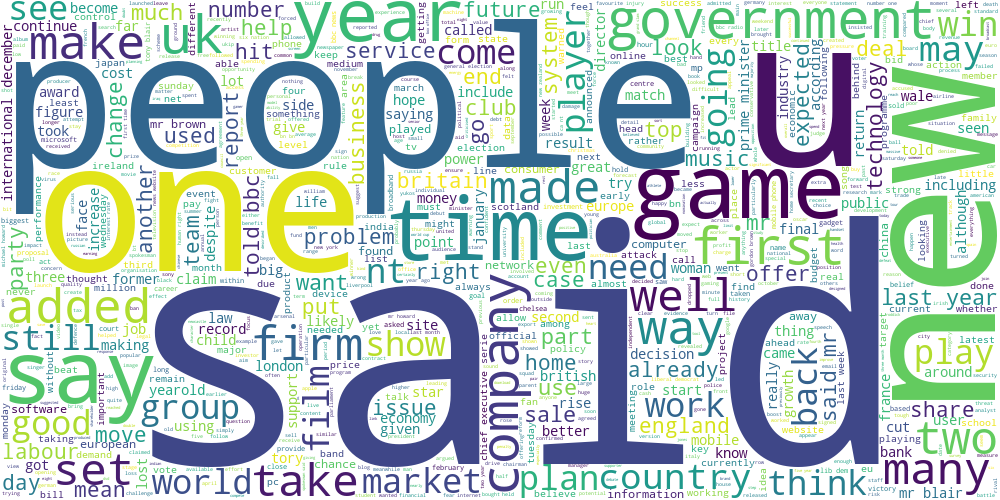

In [7]:
draw_wordcloud(data.content)

**Задание 1.3 (1 балл).** Начнем с простого: обучите алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова. Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. 


(?) Получились ли темы интерпретируемыми? Попробуйте озаглавить каждую тему.

**Ответ:**

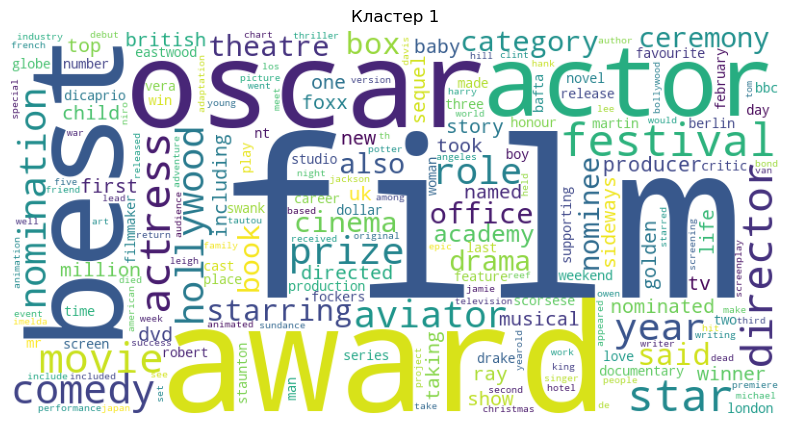

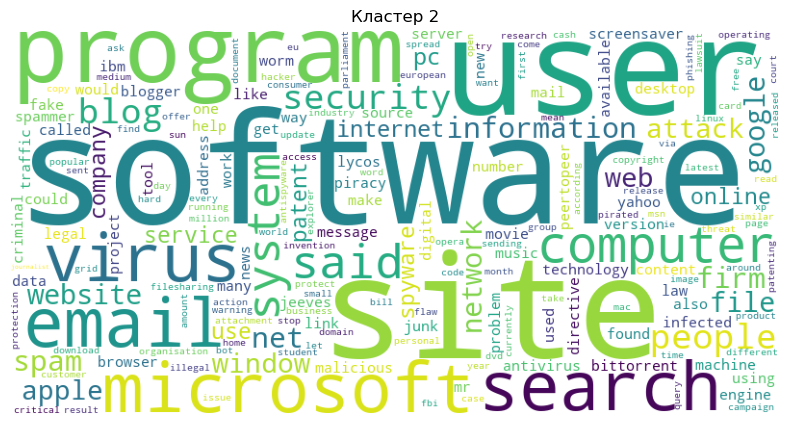

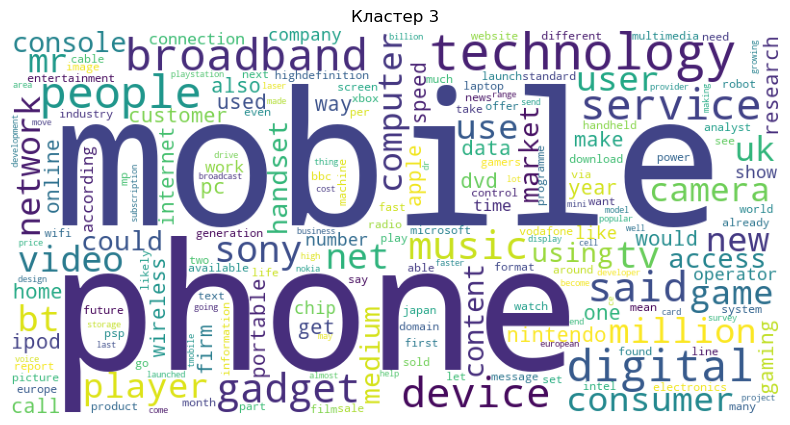

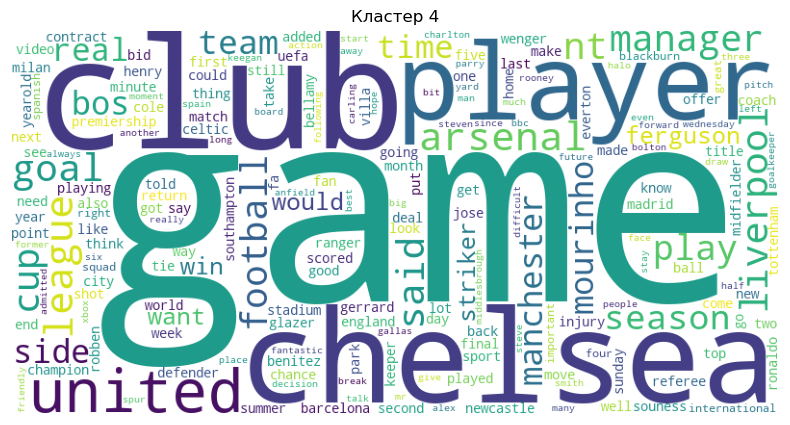

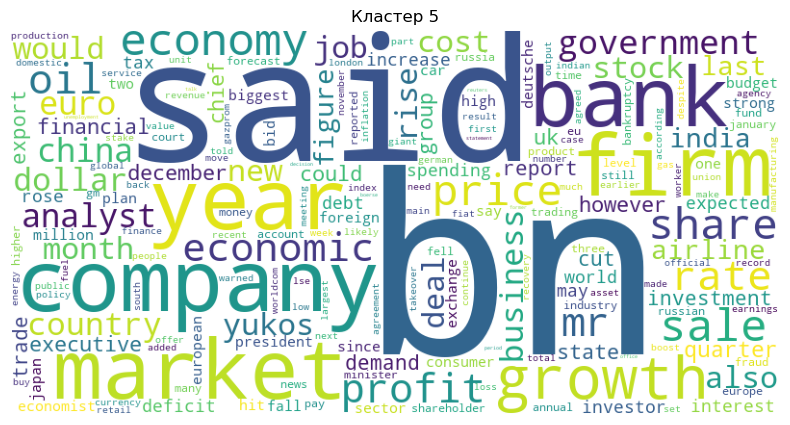

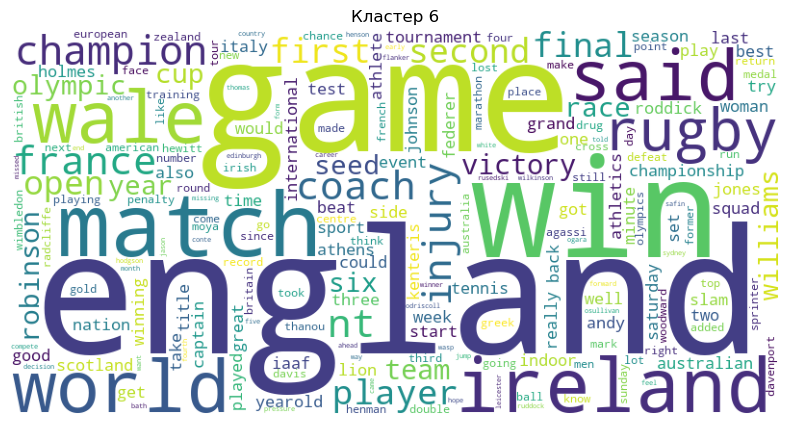

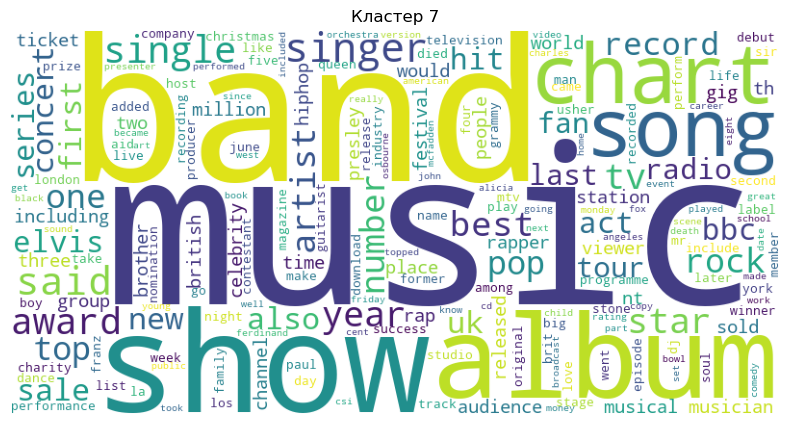

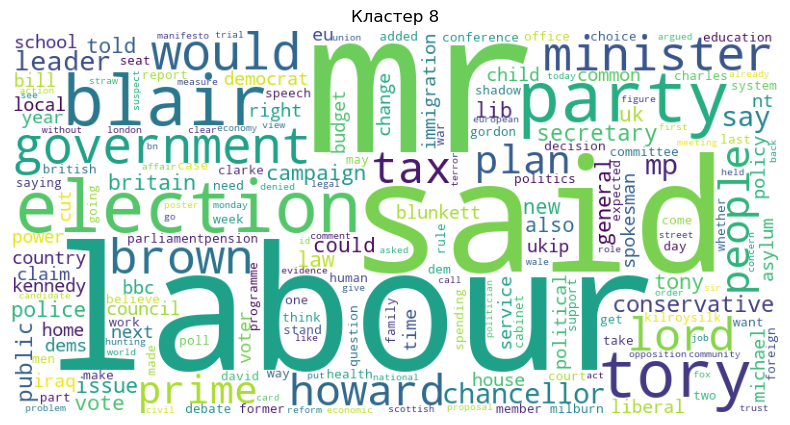

In [8]:
from sklearn.feature_extraction.text import TfidfVectorizer
import matplotlib.pyplot as plt

n_clusters = 8

vectorizer = TfidfVectorizer(max_df=0.9, min_df=5)
X_tfidf = vectorizer.fit_transform(data['content'])     # X_tfidf.shape = [n_doc, n_words] 

kmean = KMeans(n_clusters=n_clusters, random_state=42)
clusters = kmean.fit_predict(X_tfidf)
data['clusters'] = clusters

terms = vectorizer.get_feature_names_out()

for cluster_num in range(n_clusters):
    # Выбираем индексы строк, которые относятся к номеру кластера, рассматриваемому в данный момент
    cluster_indicies = data[data['clusters'] == cluster_num].index
    
    # Усредняем tf-idf для слова по всем документам
    cluster_tfidf = X_tfidf[cluster_indicies].mean(axis=0)

    # Словарь, где ключ - слово, значение - средний tf-idf
    word_weights = {
        terms[i]: cluster_tfidf[0, i] for i in cluster_tfidf.nonzero()[1]
    }
    
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(f'Кластер {cluster_num + 1}')
    plt.show()

* Кластер 1: Церемония награжения всех, причастных к созданию фильмов
* Кластер 2: Интернет и компьютерные сети
* Кластер 3: Мобильные устройства
* Кластер 4: Футбол
* Кластер 5: Экономика бизнеса
* Кластер 6: Матчи спортивных игр
* Кластер 7: Музыка
* Кластер 8: Государство

**Задание 1.4 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуйте взять центры кластеров и посмотреть на несколько слов с наибольшими числовыми значениями. (?) Соответствуют ли полученные слова облакам тегов из прошлого задания?

**Ответ:**

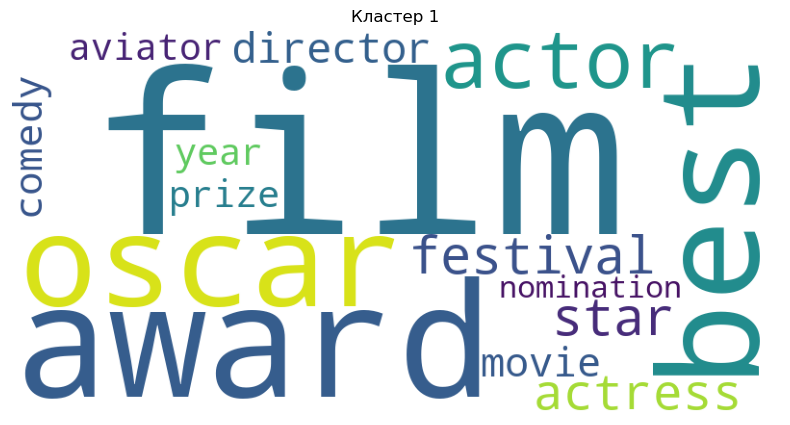

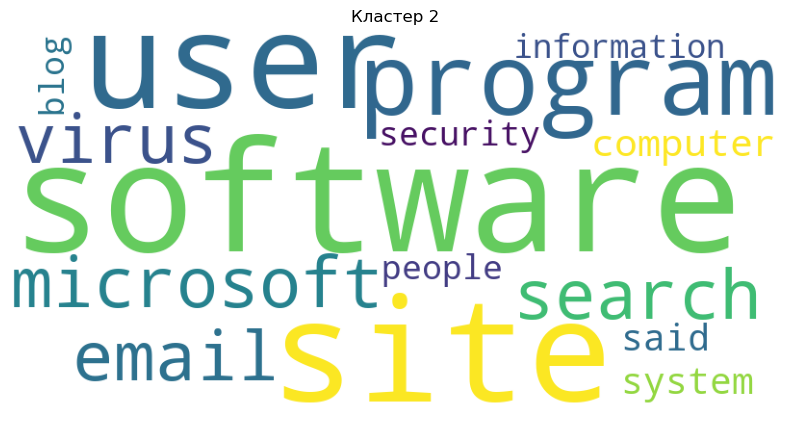

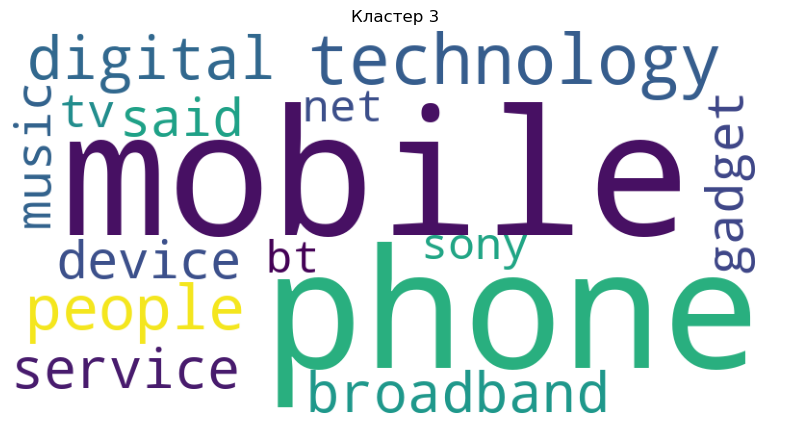

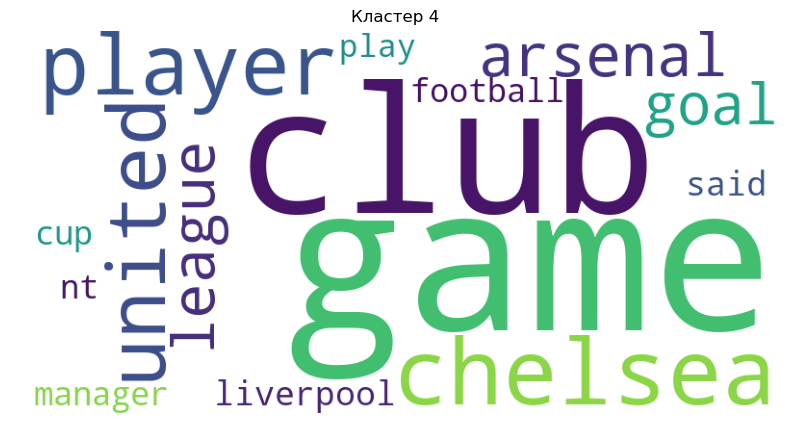

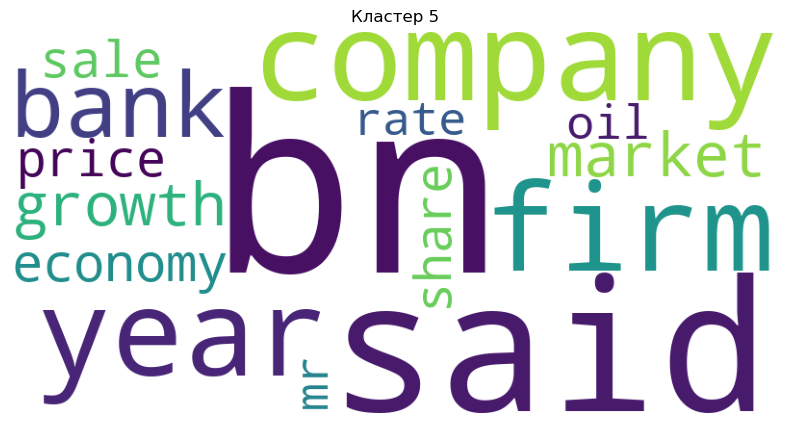

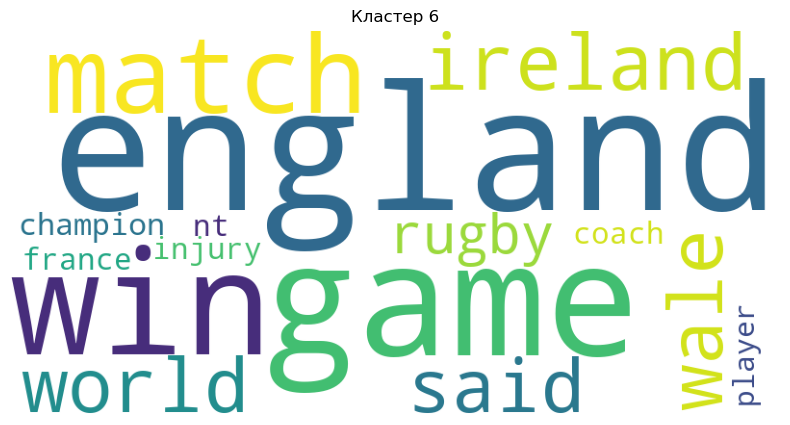

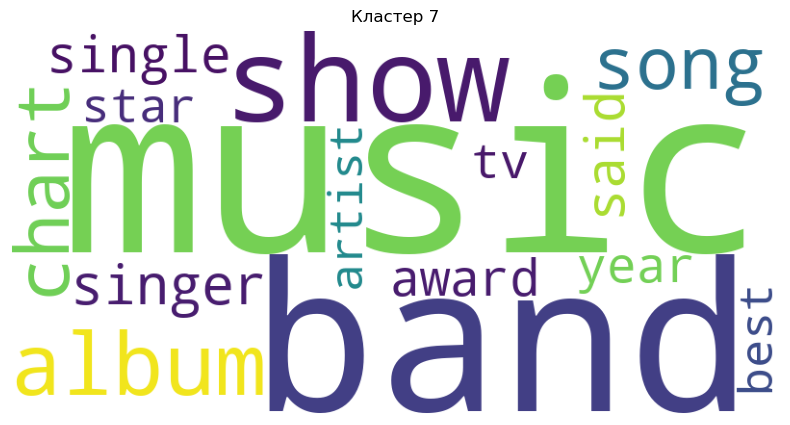

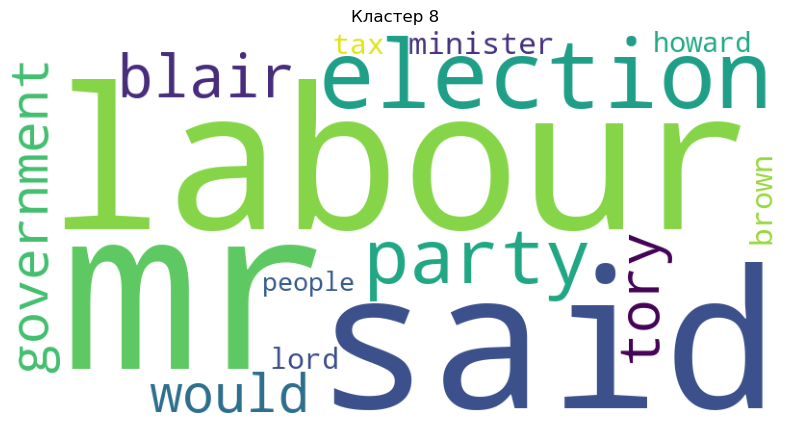

In [9]:
cluster_centers_tfidf = kmean.cluster_centers_ # shape = (n_clusters, n_words)

for cluster_num in range(n_clusters):
    top_indicies = cluster_centers_tfidf[cluster_num, :].argsort()[::-1][:15]
    word_weights = {
        terms[i]: cluster_centers_tfidf[cluster_num, i] for i in top_indicies
    }
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(f'Кластер {cluster_num + 1}')
    plt.show()

Да, мы видим, что темы облаков тегов соответствуют тегам с прошлого задания. 

**Задание 1.5 (можно получить 1.5, 1 или 2.5 баллов)** Попробуем усовершенствовать метод. Реализуйте в приведенном ниже шаблоне ядерный K-means(1.5 баллов) или эллипсоидный метод(1 балл) (можно оба сразу, тогда баллы сложатся). И попробуйте применить его для решаемой задачи. (?)Насколько существенно отличаются  центры кластеров и облака тегов от таковых для предыдущих методов?

In [10]:
from sklearn.metrics.pairwise import rbf_kernel


class KernelKMeans:
    def __init__(self, n_clusters, iters):
        """
        Kernel KMeans Class constructor.

        Args:
        n_clusters (int) : Number of clusters used for partitioning.
        iters (int) : Number of iterations until the algorithm stops.

        """
        self.n_clusters = n_clusters
        self.iters = iters
 
    def initialize_clusters(self, X, n_clusters):
        """
        Initialize centroids.

        Args:
        X (ndarray): Dataset samples
        n_clusters (int): Number of clusters

        Returns:
        centroids (ndarray): Initial position of centroids
        """
        labels = np.random.randint(n_clusters, size=X.shape[0])
        return labels

 
    def fit_predict(self, X):
        """
        Implementation of the kernel KMeans algorithm.

        Args:
        X (ndarray): Dataset samples

        Returns:
            centroids (ndarray): Computed centroids
            labels (ndarray): Predicts for each sample in the dataset.
        """
     
        self.X = X
        # Назначаем случайные кластеры всем объектам. Аналог назначения центроидов для обычного K-means
        labels = self.initialize_clusters(X, self.n_clusters)
        # K = exp(-gamma * ||x_i - x_j||^2). Содержит в себе расстояние между x_i, x_j. Если точки близки: -> 1, если далеки: -> 0
        # K_dist.shape = (n_samples, n_samples); n_samples - количество объектов в выборке = n_samples
        K_dist = rbf_kernel(X)

        n_samples = X.shape[0]  # Количество объектов в выборке

        for _ in range(self.iters):
            distances = np.zeros((self.n_clusters, n_samples))
            
            for cluster_num in range(self.n_clusters):
                mask = labels == cluster_num
                N_k = np.sum(mask)  # Количество объектов в кластере

                if N_k == 0:
                    continue

                K_i = K_dist[:, mask]  # (n_samples, N_k) — расстояние от объекта до других объектов в этом же кластере     
                K_k = K_dist[np.ix_(mask, mask)]  # (N_k, N_k) - расстояние между объектами в кластере

                # Обновляем расстояние между объектами для текущего кластера (использя ядерную функцию) (в строке все объекты для 1 кластера)
                distances[cluster_num] = np.diag(K_dist) - 2 * np.sum(K_i, axis=1) / N_k + np.sum(K_k) / (N_k ** 2)
            
            # Вычисляем минимальное расстояние от объекта до какого-то кластера
            new_labels = np.argmin(distances, axis=0)

            if np.all(labels == new_labels):
                break
            labels = new_labels

        self.labels = labels
        self.centroids = self.get_centroids()
        return self.centroids, self.labels
            
    
    def get_centroids(self):
        """
        Return the computed centroids
        """
        X = self.X
        centroids = np.zeros((self.n_clusters, X.shape[1]))
        for cluster_num in range(self.n_clusters):
            mask = self.labels == cluster_num
            if np.sum(mask) > 0:
                centroids[cluster_num] = np.mean(X[mask], axis=0)
        return centroids

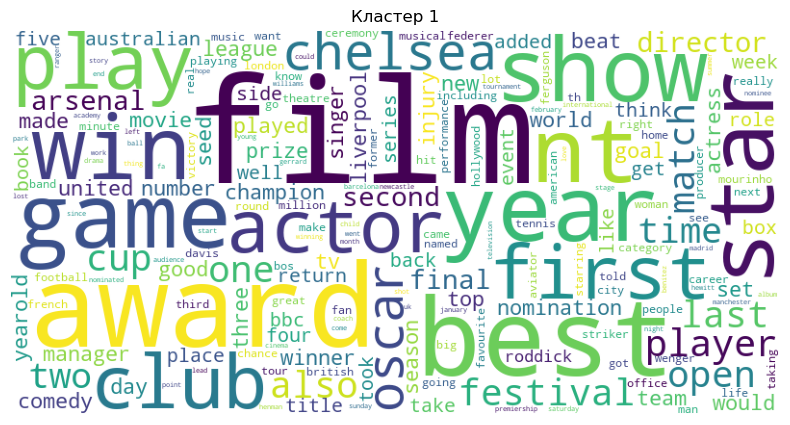

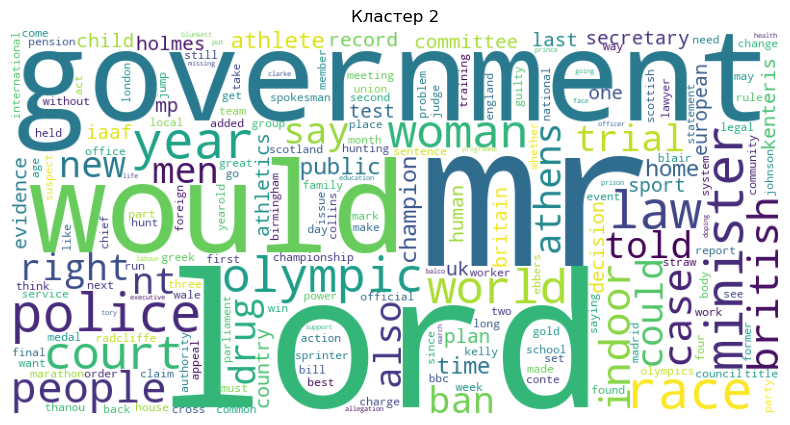

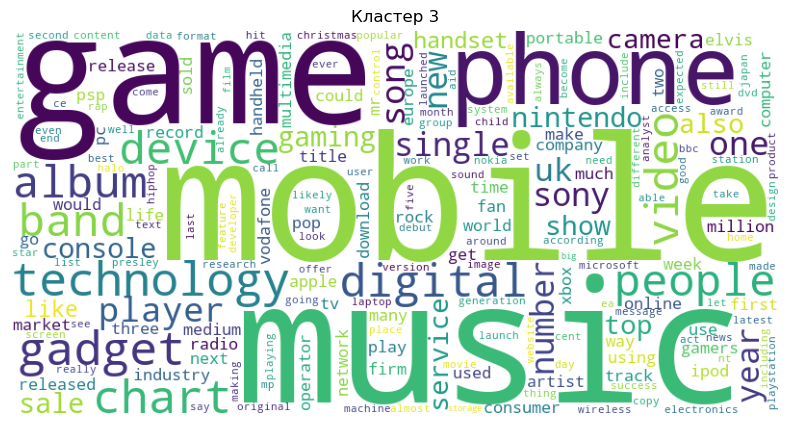

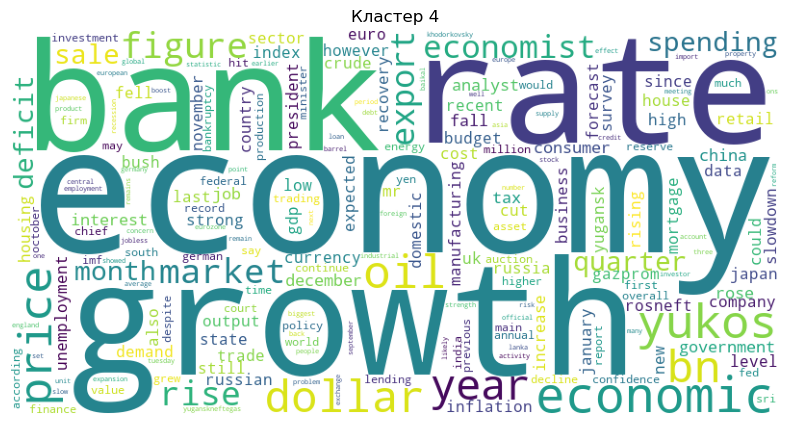

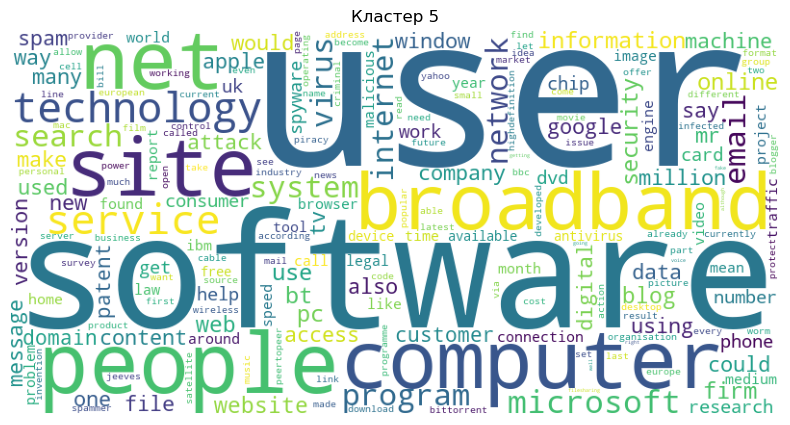

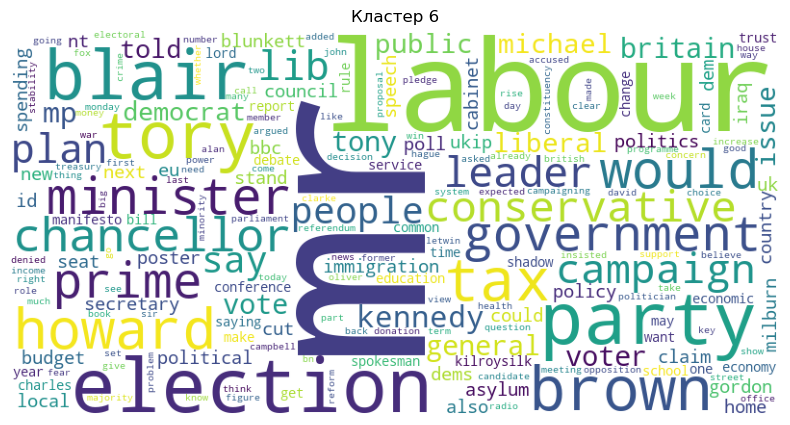

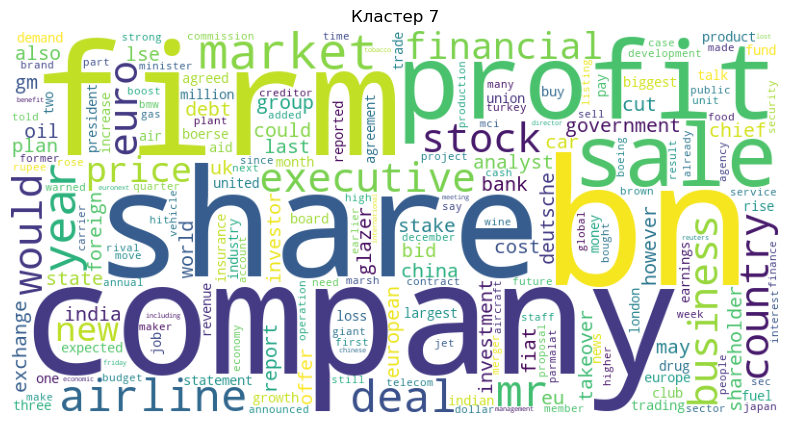

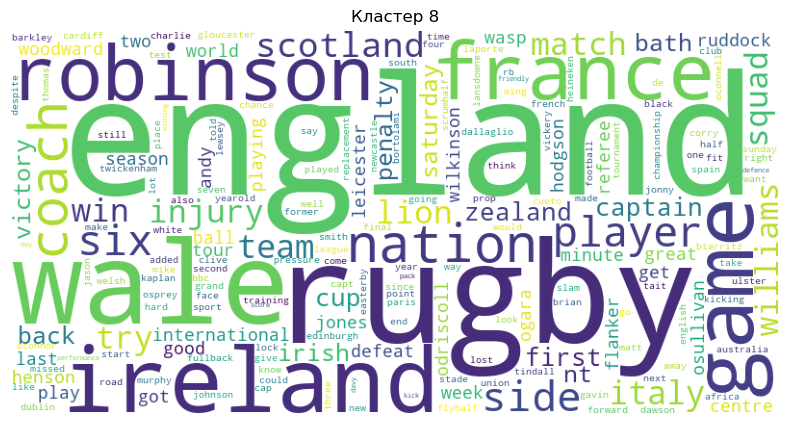

In [11]:
# ПРОВЕРЯЕМ ЯДЕРНЫЙ KMeans 

n_clusters = 8

vectorizer = TfidfVectorizer(max_df=0.9, min_df=5)
X_tfidf = vectorizer.fit_transform(data['content'])     # X_tfidf.shape = [n_doc, n_words] 

kernel_kmean = KernelKMeans(n_clusters=n_clusters, iters=100)
clusters = kernel_kmean.fit_predict(X_tfidf)
_, data['clusters_kernel'] = clusters

terms = vectorizer.get_feature_names_out()

for cluster_num in range(n_clusters):
    # Выбираем индексы строк, которые относятся к номеру кластера, рассматриваемому в данный момент
    cluster_indicies = data[data['clusters_kernel'] == cluster_num].index
    
    # Усредняем tf-idf для слова по всем документам
    cluster_tfidf = X_tfidf[cluster_indicies].mean(axis=0)

    # Словарь, где ключ - слово, значение - средний tf-idf
    word_weights = {
        terms[i]: cluster_tfidf[0, i] for i in cluster_tfidf.nonzero()[1]
        if terms[i] != "said"
    }
    
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(f'Кластер {cluster_num + 1}')
    plt.show()

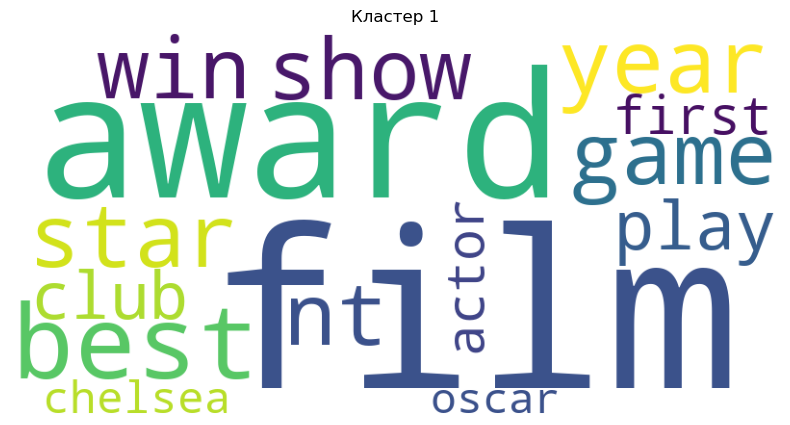

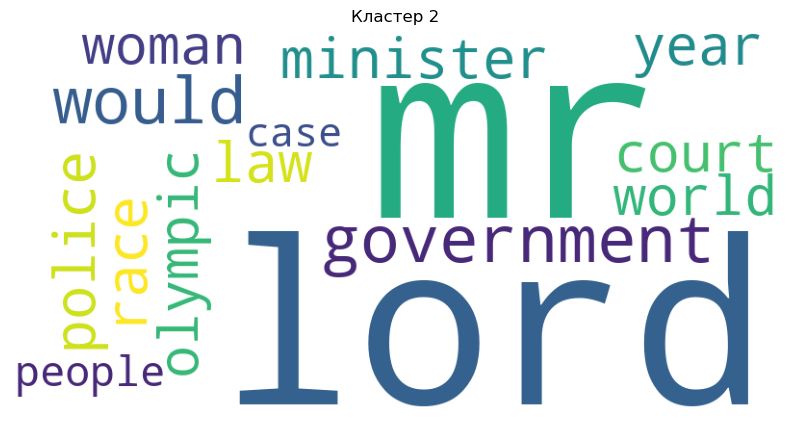

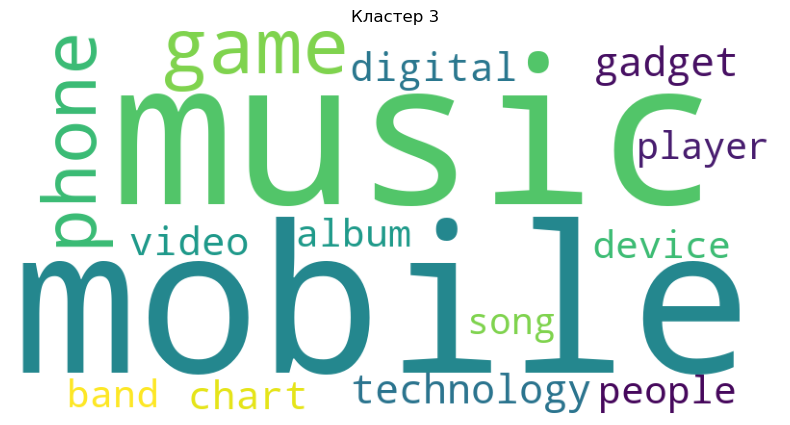

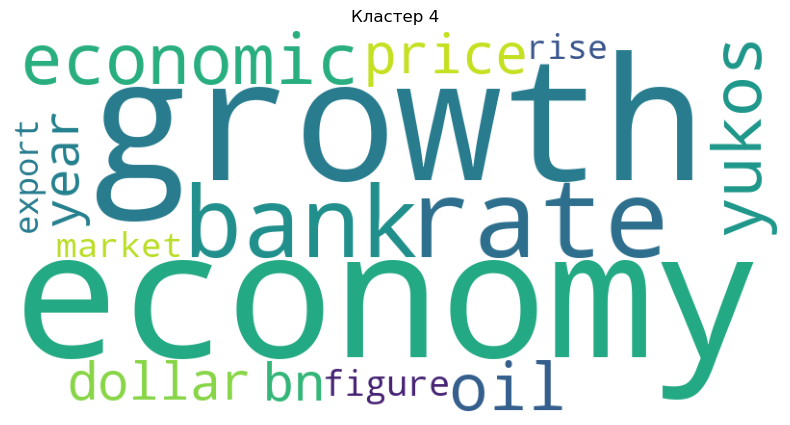

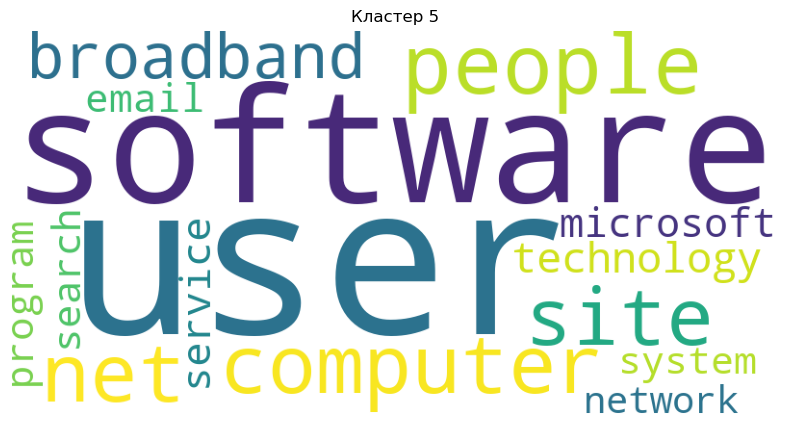

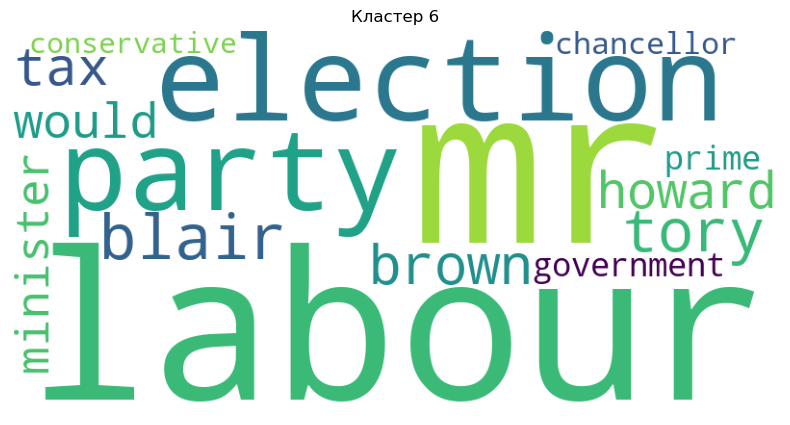

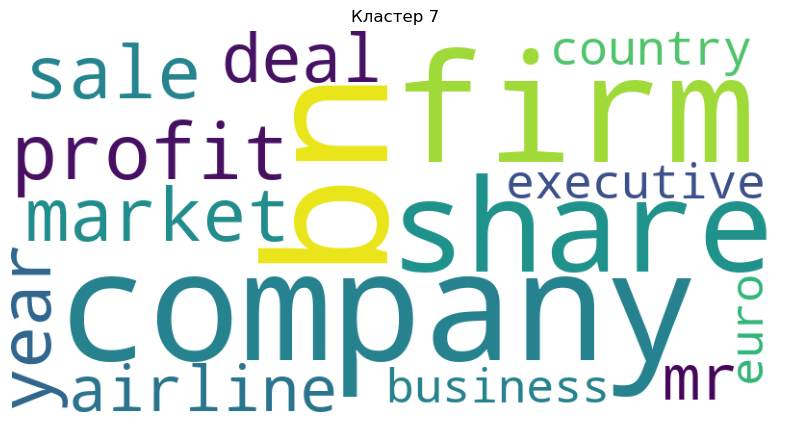

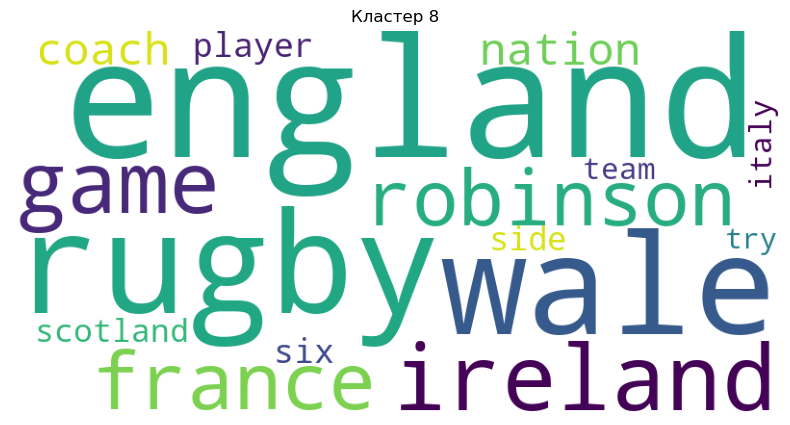

In [12]:
cluster_centers_tfidf = kernel_kmean.get_centroids() # shape = (n_clusters, n_words)

for cluster_num in range(n_clusters):
    top_indicies = cluster_centers_tfidf[cluster_num, :].argsort()[::-1][:16]
    word_weights = {
        terms[i]: cluster_centers_tfidf[cluster_num, i] for i in top_indicies
        if terms[i] != "said"
    }
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(f'Кластер {cluster_num + 1}')
    plt.show()

In [13]:
from scipy.sparse import csr_matrix
from sklearn.decomposition import TruncatedSVD

class EllipsoidKMeans:
    def __init__(self, n_clusters, iters, gamma=1.0, n_components=100):
        """
        Ellipsoid KMeans Class constructor.

        Args:
        n_clusters (int): Number of clusters used for partitioning.
        iters (int): Number of iterations until the algorithm stops.
        gamma (float): Kernel coefficient for RBF kernel.
        n_components (int): Number of components for dimensionality reduction (e.g., using Truncated SVD).
        """
        self.n_clusters = n_clusters
        self.iters = iters
        self.gamma = gamma
        self.n_components = n_components

    def initialize_clusters(self, X, n_clusters):
        """
        Initialize clusters with random labels.

        Args:
        X (ndarray): Dataset samples.
        n_clusters (int): Number of clusters.

        Returns:
        labels (ndarray): Initial cluster assignments.
        """
        labels = np.random.randint(n_clusters, size=X.shape[0])
        return labels

    def mahalanobis_distance(self, X, center, cov_matrix):
        """
        Compute the Mahalanobis distance between data points and a cluster center.

        Args:
        X (ndarray): Data samples (n_samples, n_features)
        center (ndarray): Cluster center (1, n_features)
        cov_matrix (ndarray): Covariance matrix of the cluster (n_features, n_features)

        Returns:
        distance (ndarray): Mahalanobis distances for each sample to the cluster center.
        """
        diff = X - center
        cov_inv = np.linalg.inv(cov_matrix)
        return np.sqrt(np.sum(np.dot(diff, cov_inv) * diff, axis=1))

    def fit_predict(self, X):
        """
        Implementation of the Ellipsoid KMeans algorithm.

        Args:
        X (ndarray): Dataset samples.

        Returns:
        labels (ndarray): Cluster assignments for each sample in the dataset.
        """
        self.X = X
        # Уменьшаем размерность данных с помощью Truncated SVD
        svd = TruncatedSVD(n_components=self.n_components)
        X_reduced = svd.fit_transform(X)

        labels = self.initialize_clusters(X_reduced, self.n_clusters)
        n_samples = X_reduced.shape[0]

        for _ in range(self.iters):
            distances = np.zeros((self.n_clusters, n_samples))
            
            # Ковариационная матрица для каждого кластера
            cov_matrices = np.zeros((self.n_clusters, X_reduced.shape[1], X_reduced.shape[1]))

            for cluster_num in range(self.n_clusters):
                mask = labels == cluster_num
                N_k = np.sum(mask)

                if N_k == 0:
                    continue

                # объекты в текущем кластере
                cluster_data = X_reduced[mask]

                # Преобразуем в плотную матрицу, если это разреженная матрица
                if isinstance(cluster_data, csr_matrix):
                    cluster_data = cluster_data.toarray()

                # Вычисляем центроид кластера
                centroid = np.mean(cluster_data, axis=0)

                # Вычисляем ковариационную матрицу для этого кластера
                cov_matrix = np.cov(cluster_data.T)
                cov_matrices[cluster_num] = cov_matrix

                # Вычисляем расстояние Махаланобиса для каждого объекта
                distances[cluster_num] = self.mahalanobis_distance(X_reduced, centroid, cov_matrix)

            # Вычисляем минимальное расстояние от объекта до какого-то кластера
            new_labels = np.argmin(distances, axis=0)

            # Проверка на сходимость
            if np.all(labels == new_labels):
                break
            labels = new_labels

        self.labels = labels
        return self.labels

    def get_centroids(self):
        """
        Return the computed centroids (for simplicity, the centers of the clusters).
        """
        X = self.X
        centroids = np.zeros((self.n_clusters, X.shape[1]))
        for cluster_num in range(self.n_clusters):
            mask = self.labels == cluster_num
            if np.sum(mask) > 0:
                centroids[cluster_num] = np.mean(X[mask], axis=0)
        return centroids


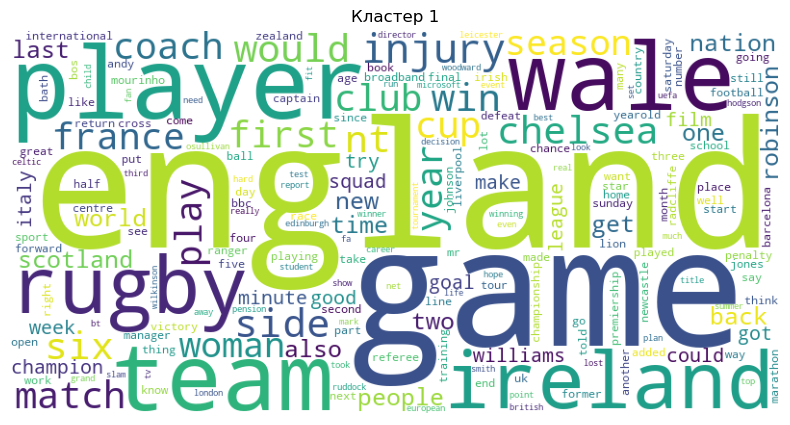

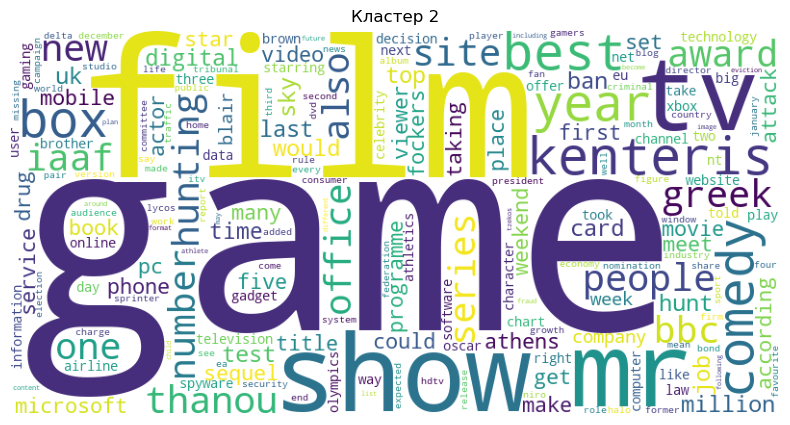

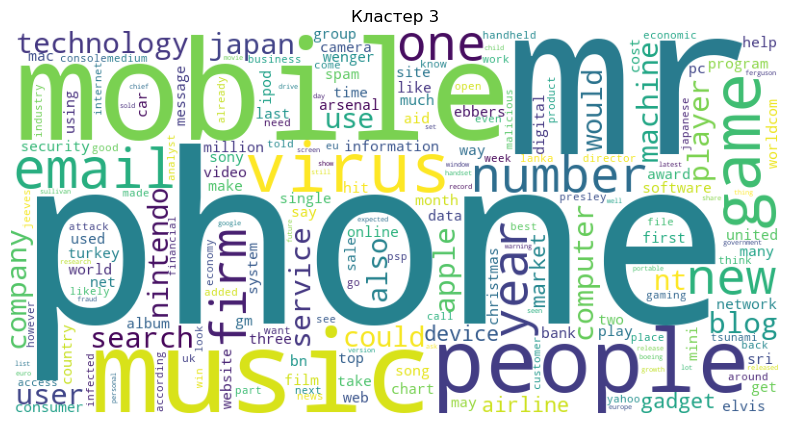

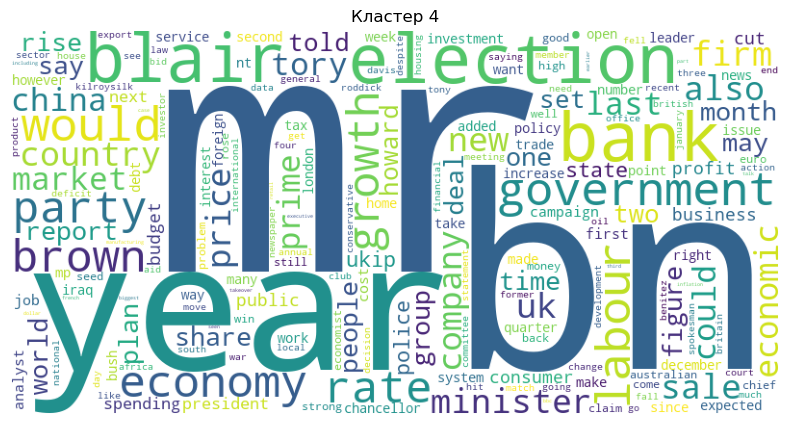

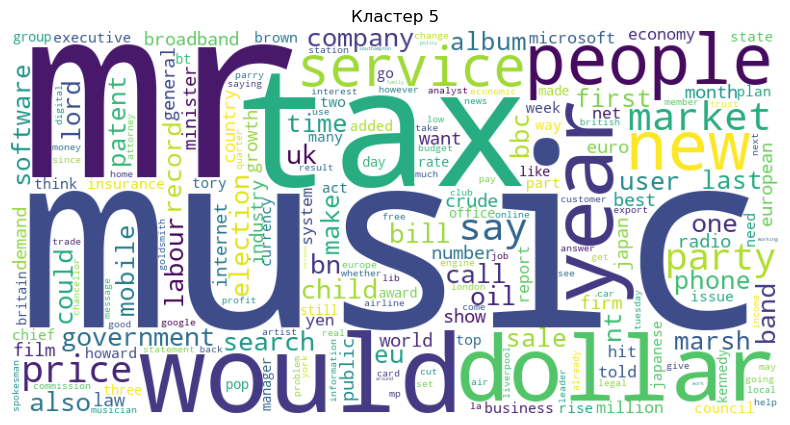

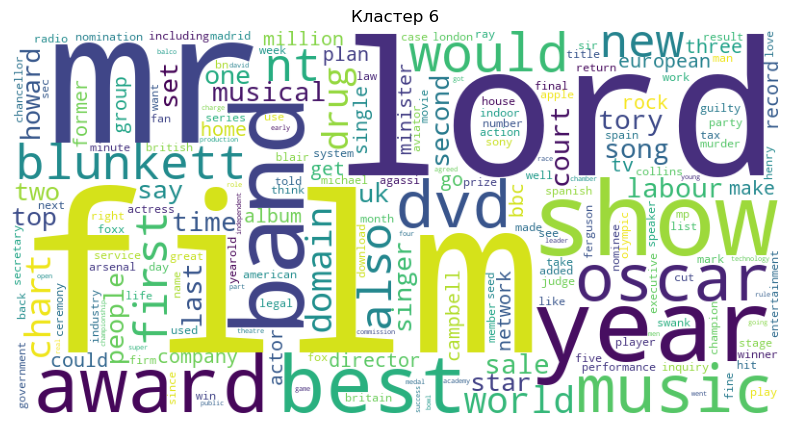

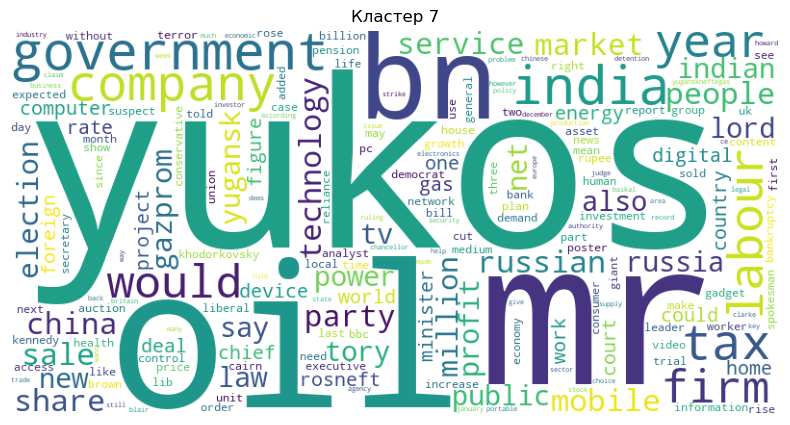

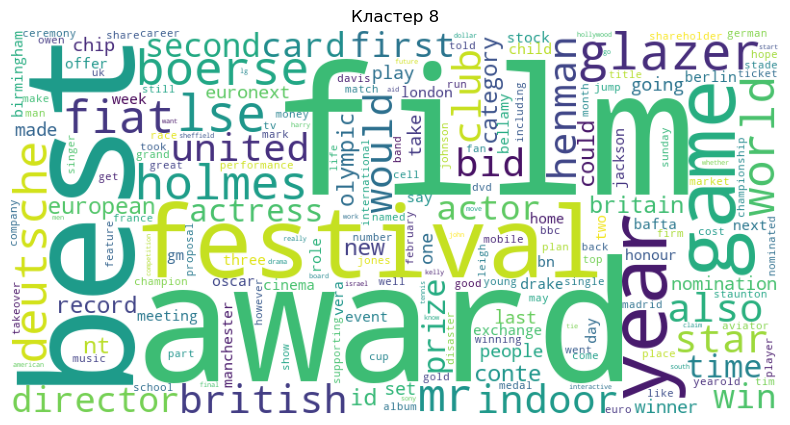

In [14]:
# ПРОВЕРЯЕМ ЭЛЛИПСОИДНЫЙ KMeans 


n_clusters = 8

vectorizer = TfidfVectorizer(max_df=0.9, min_df=5)
X_tfidf = vectorizer.fit_transform(data['content'])     # X_tfidf.shape = [n_doc, n_words] 

ellips_kmean = EllipsoidKMeans(n_clusters=n_clusters, iters=100)
clusters = ellips_kmean.fit_predict(X_tfidf)
data['clusters_ellips'] = clusters

terms = vectorizer.get_feature_names_out()

for cluster_num in range(n_clusters):
    # Выбираем индексы строк, которые относятся к номеру кластера, рассматриваемому в данный момент
    cluster_indicies = data[data['clusters_ellips'] == cluster_num].index
    
    # Усредняем tf-idf для слова по всем документам
    cluster_tfidf = X_tfidf[cluster_indicies].mean(axis=0)

    # Словарь, где ключ - слово, значение - средний tf-idf
    word_weights = {
        terms[i]: cluster_tfidf[0, i] for i in cluster_tfidf.nonzero()[1]
        if terms[i] != "said"
    }
    
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(f'Кластер {cluster_num + 1}')
    plt.show()

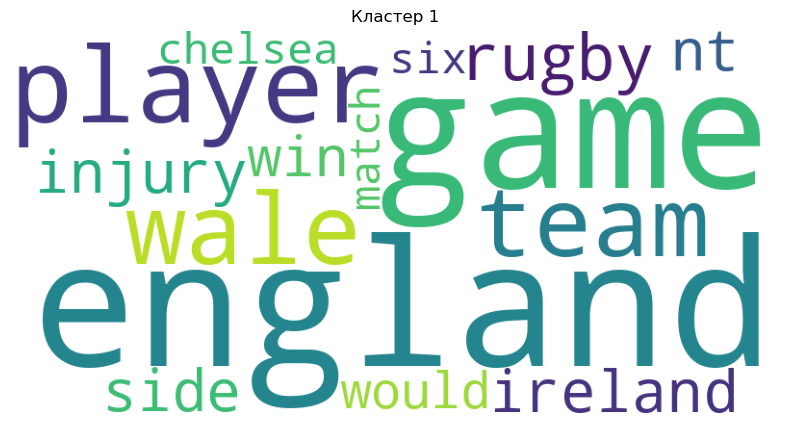

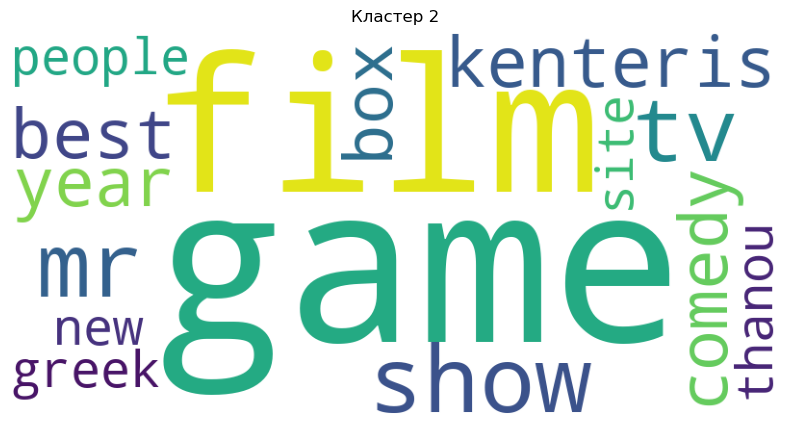

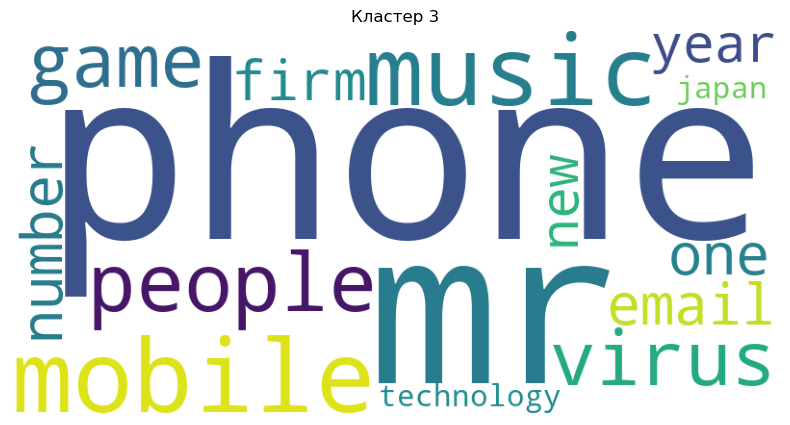

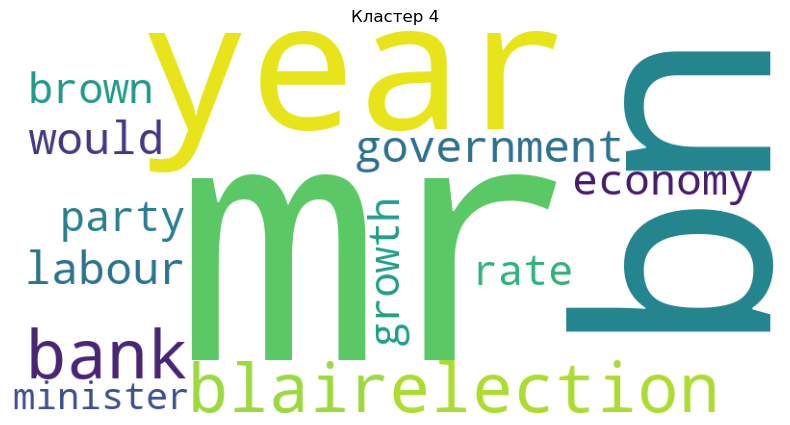

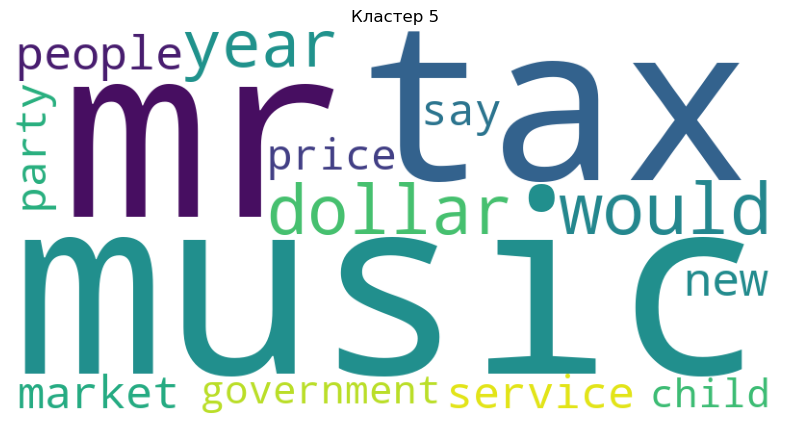

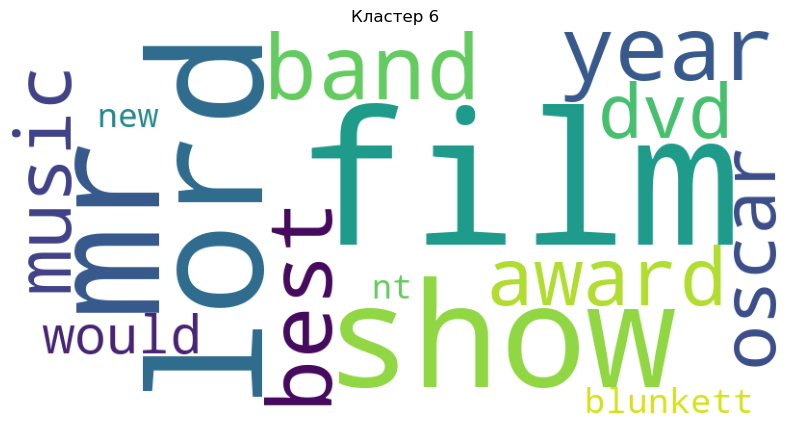

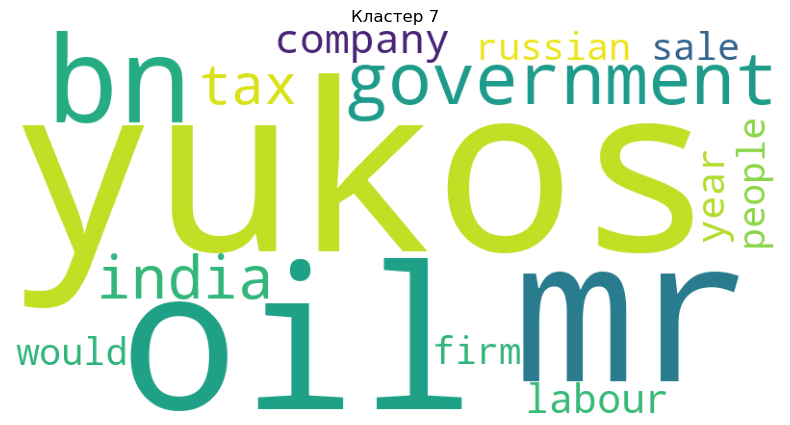

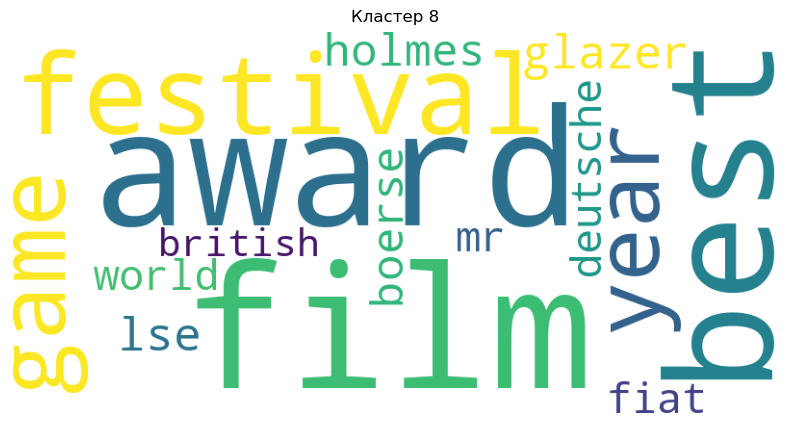

In [15]:
cluster_centers_tfidf = ellips_kmean.get_centroids() # shape = (n_clusters, n_words)

for cluster_num in range(n_clusters):
    top_indicies = cluster_centers_tfidf[cluster_num, :].argsort()[::-1][:16]
    word_weights = {
        terms[i]: cluster_centers_tfidf[cluster_num, i] for i in top_indicies
        if terms[i] != "said"
    }
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)
    wordcloud = WordCloud(width=800, height=400, background_color='white')
    wordcloud.generate_from_frequencies(word_weights)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud)
    plt.axis("off")
    plt.title(f'Кластер {cluster_num + 1}')
    plt.show()

| Column 1 | Kernel | Ellipsoid |
|----------|----------|----------|
| **Cluster1**    | Фильмы, награждение   | Рэгби, Англия против кого-то   |
| **Cluster2**    | Политика   | Игры, телепередачи, фильмы   |
| **Cluster3**    | Телефон, интернет-технологии   | Телефон, интернет-технологии    |
| **Cluster4**    | Экономика   | Правительство   |
| **Cluster5**    | Компьютеры   | Гос.экономика и музыка  |
| **Cluster6**    | Выборы   | Фильмы и телешоу   |
| **Cluster7**    | Фирмы и компании   | Нефть    |
| **Cluster8**    | Рэгби   | Фильмы, награждение    |

Видим, что темы в целом похожи, однако порядок их различается. 

В общем, несмотря на то, что темы (кластерные группы) в обоих методах могут быть похожи, различия в методах кластеризации и в параметрах обработки данных могут приводить к разным результатам в распределении данных по кластерам


Темы схожи с темами при обычном KMeans

**Задание 1.6 (0.5 балла).** Теперь попробуем сравнить три разных алгоритма кластеризации. Получите три разбиения на кластеры с помощью алгоритмов K-Means(любого понравившегося), DBSCAN(можно взять готовый из sklearn) и спектральной кластеризации, реализованной вами выше. Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

Лучший eps для 7 кластеров: 0.4157894736842105


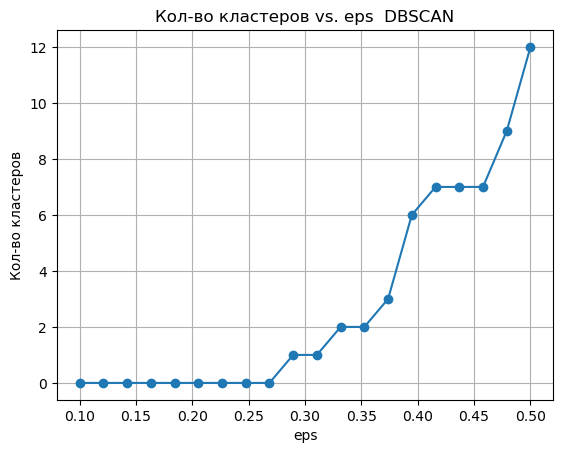

In [16]:
from sklearn.cluster import DBSCAN

# Узнаем лучший eps для DBSCAN

def get_num_clusters(dbscan, X):
    labels = dbscan.fit_predict(X)
    return len(set(labels)) - (1 if -1 in labels else 0)  # Исключаем шум (метка -1)

eps_values = np.linspace(0.1, 0.5, 20)
cluster_counts = []

vectorizer = TfidfVectorizer(max_df=0.9, min_df=5)
X_tfidf = vectorizer.fit_transform(data['content'])

for eps in eps_values:
    dbscan = DBSCAN(eps=eps, min_samples=7, metric='cosine')
    num_clusters = get_num_clusters(dbscan, X_tfidf)
    cluster_counts.append(num_clusters)

best_eps = eps_values[np.argmin(np.abs(np.array(cluster_counts) - 7))]
print(f"Лучший eps для 7 кластеров: {best_eps}")

plt.plot(eps_values, cluster_counts, marker='o')
plt.xlabel('eps')
plt.grid(True)
plt.ylabel('Кол-во кластеров')
plt.title('Кол-во кластеров vs. eps  DBSCAN')
plt.show()

Ищем именно 7 кластеров, а не 8, потому что 2 темы получились очень близкими к значению "спортивная игра", и хотелось бы объединить их в одну

*Spoiler* не получилось

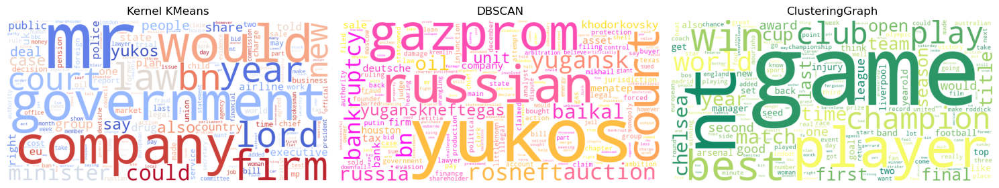

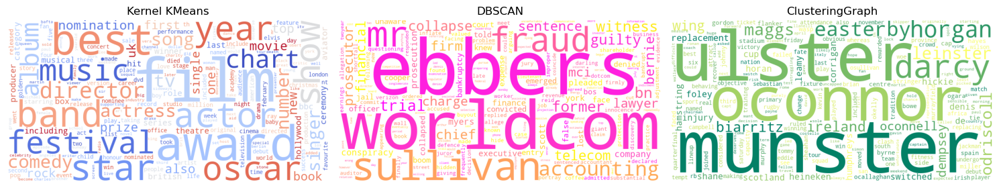

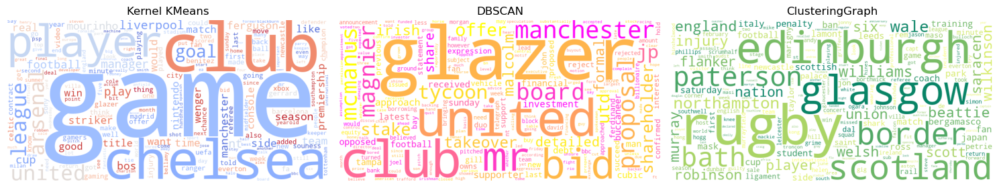

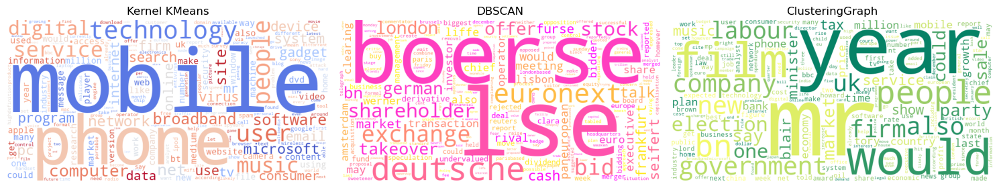

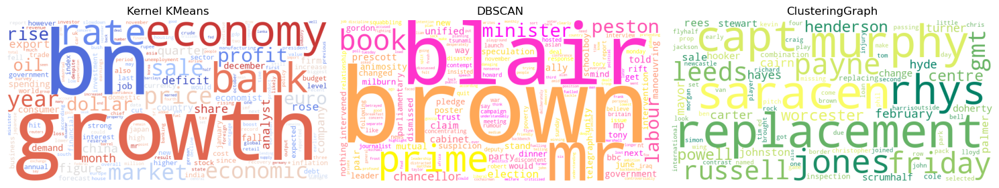

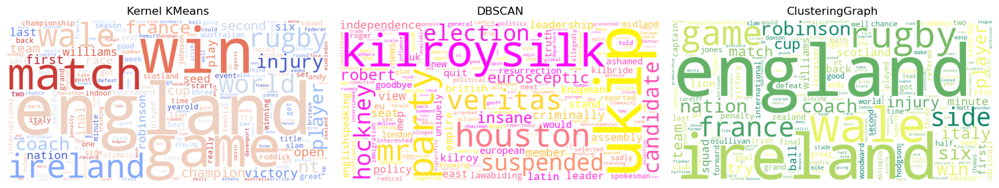

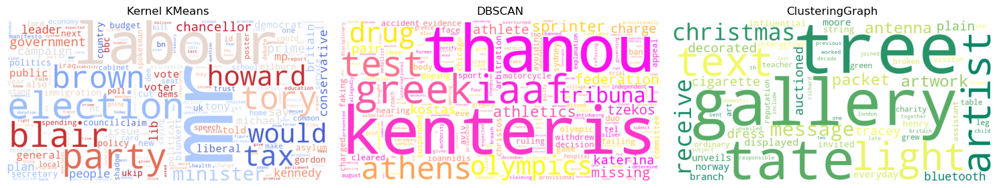

In [17]:
from sklearn.metrics.pairwise import cosine_similarity


n_clusters = 7

kmean = KernelKMeans(n_clusters=n_clusters, iters=100)
dbscan = DBSCAN(eps=best_eps, min_samples=7, metric='cosine')
graph_clust = GraphClustering(n_clusters=n_clusters)

X_tfidf = vectorizer.fit_transform(data['content'])
# Вычисляем косинусное сходство между всеми парами документов, что даёт матрицу схожести размером (n_samples, n_samples).
similarity_matrix = cosine_similarity(X_tfidf)  # косинусное сходство между всеми документами

_, clusters_kmean = kmean.fit_predict(X_tfidf)
clusters_dbscan = dbscan.fit_predict(X_tfidf)
cluster_graph = graph_clust.fit_predict(similarity_matrix)

data['clusters_kmean'] = clusters_kmean
data['clusters_dbscan'] = clusters_dbscan
data['clusters_graph'] = cluster_graph

terms = vectorizer.get_feature_names_out()

for cluster_num in range(n_clusters):

    cluster_indicies_kmean = data[data['clusters_kmean'] == cluster_num].index
    cluster_indicies_dbscan = data[data['clusters_dbscan'] == cluster_num].index
    cluster_indicies_graph = data[data['clusters_graph'] == cluster_num].index
    
    cluster_tfidf_kmean = X_tfidf[cluster_indicies_kmean].mean(axis=0)
    cluster_tfidf_dbscan = X_tfidf[cluster_indicies_dbscan].mean(axis=0)
    cluster_tfidf_graph = X_tfidf[cluster_indicies_graph].mean(axis=0)

    word_weights_kmean = {
        terms[i]: cluster_tfidf_kmean[0, i] for i in cluster_tfidf_kmean.nonzero()[1]
        if terms[i] != "said"
    }
    word_weights_dbscan = {
        terms[i]: cluster_tfidf_dbscan[0, i] for i in cluster_tfidf_dbscan.nonzero()[1]
        if terms[i] != "said"
    }
    word_weights_graph = {
        terms[i]: cluster_tfidf_graph[0, i] for i in cluster_tfidf_graph.nonzero()[1]
        if terms[i] != "said"
    }

    wordcloud_kmean = WordCloud(width=800, height=400, background_color='white', colormap='coolwarm')
    wordcloud_kmean.generate_from_frequencies(word_weights_kmean)
    name = "KernelKmeans"

    wordcloud_dbscan = WordCloud(width=800, height=400, background_color='white', colormap='spring')
    wordcloud_dbscan.generate_from_frequencies(word_weights_dbscan)
    name = "DBSCAN"

    wordcloud_graph = WordCloud(width=800, height=400, background_color='white', colormap='summer')
    wordcloud_graph.generate_from_frequencies(word_weights_graph)
    name = "ClusteringGraph"

    fig, axes = plt.subplots(1, 3, figsize=(15, 7))

    # Для каждого подграфика генерируем нужное облако слов
    axes[0].imshow(wordcloud_kmean)
    axes[0].axis("off")
    axes[0].set_title("Kernel KMeans")

    axes[1].imshow(wordcloud_dbscan)
    axes[1].axis("off")
    axes[1].set_title("DBSCAN")

    axes[2].imshow(wordcloud_graph)
    axes[2].axis("off")
    axes[2].set_title("ClusteringGraph")

    plt.tight_layout()
    plt.show()
        

(?) Теперь постройте облака слов и снова проинтерпретируйте темы. 

| Column 1 | Kernel | DBSCAN | ClusteringFpaph |
|----------|----------|----------|----------|
| **Cluster1**    | Правительство, бизнес   | Нефть  | Спортивные игры |
| **Cluster2**    | Награждения за фильм   | что-то неинтерпретируемое  | Имена собственные |
| **Cluster3**    | Спортивныее игры   | Все подряд    | Куча мала и рэгби |
| **Cluster4**    | Мобильный телефон   | Биржа   | Фильм и правительство |
| **Cluster5**    | Банки и компании   | куча мала  | непонятная хтонь |
| **Cluster6**    | Спортинвые матчи   | Государство   | Спортивные матчи по ржгби! |
| **Cluster7**    | Выборы   | Древнегреческое    | Набор случайных слов |

Видим, что темы могут повторяться даже в пределах 1 алгоритма. При плохом разбиении на кластеры вместо осмысленной темы получается какой-то бред

**Задание 1.6 (1 балл).** Также, для анализа качества кластеризации иногда бывает полезно "посмотреть" накластеры. Обучите двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Лучше всего расположить визуализации на одном графике на трех разных сабплотах. Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

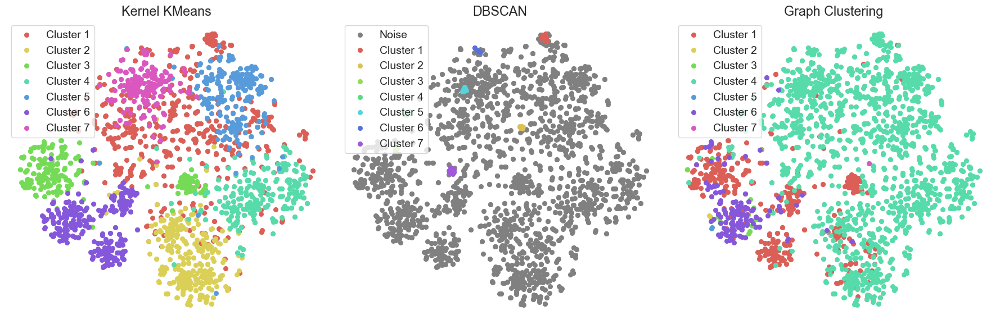

In [18]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import seaborn as sns

# Обновляем параметры визуализации
plt.rcParams.update({'font.size': 14})
sns.set_style('whitegrid')

tsne = TSNE(n_components=2, random_state=42)

# Применяем t-SNE к tf-idf признакам
X_tfidf_tsne = tsne.fit_transform(X_tfidf.toarray())

# Настроим графику
fig, axes = plt.subplots(1, 3, figsize=(18, 6))


def plot_tsne_clusters(axes, ax_index, X_tsne, labels, title):
    # Для DBSCAN помечаем шумовые точки как -1
    unique_labels = np.unique(labels)
    colors = sns.color_palette("hls", len(unique_labels))

    ax = axes[ax_index]
    
    for label in unique_labels:
        if label == -1:  # Шумовые точки для DBSCAN
            ax.scatter(X_tsne[labels == label, 0], X_tsne[labels == label, 1], 
                       c='gray', label="Noise", s=30)
        else:
            ax.scatter(X_tsne[labels == label, 0], X_tsne[labels == label, 1], 
                       c=[colors[label]], label=f"Cluster {label+1}", s=30)
    
    ax.set_title(title)
    ax.legend(loc="best")
    ax.axis('off')

# Визуализируем для каждого алгоритма
plot_tsne_clusters(axes, 0, X_tfidf_tsne, clusters_kmean, "Kernel KMeans")
plot_tsne_clusters(axes, 1, X_tfidf_tsne, clusters_dbscan, "DBSCAN")
plot_tsne_clusters(axes, 2, X_tfidf_tsne, cluster_graph, "Graph Clustering")

# Показываем итоговый график
plt.tight_layout()
plt.show()


(?) Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Сделаете выводы о каждом исследованном в части 1 алгоритме и их применимости к задаче тематического моделирования. **За отсутствие выводов будет наложен штраф до 2.5 баллов.**

**Ответ:**
Kernel Kmeans показывает себ очень хорошо, достаточно точно делит данные на различные кластеры отедльных тем

Видим, что DBSCAN сопоставляет друг другу в кластеры только очень близкие объекты. Это связано с тонкой настройкой гиперпараметров min_samples и eps. Компоненты, которые не были отнесены в класс, помечаются как "шумные", что на графике обозначено серым цветом. Таких данных получилось многовато, потому что "радиус" действия алгоритма маленький.

Graph Clustering довольно сильно рассеивает данные, вбирая в кластеры отельных тем довольно много далеко стоящих друг от друга точек. Это может произойти потому, что тексты, которые кажутся похожими на поверхности (например, слова, которые встречаются в обеих текстах), могут быть на самом деле далеко расположены в пространстве признаков.

## Часть 2. Transfer learning для задачи классификации текстов.

**Задание 3.1 (4 балла).** Вспомним, что у нас есть разметка для тематик статей. Просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 1:13:6. 70% выборки будем использовать для обучения, а остальные 30% для валидации

Обучите метрику Махаланобиса любыми **тремя**  методами (отсюда)[http://contrib.scikit-learn.org/metric-learn/supervised.html] только на маленьком куске (5%) обучающей выборки. Кластеризуйте данные методом k-means с обученными метриками  и проанализирйте полученные результаты. 

Сравните 3 подхода к класификации:

Логистическая регрессия на tf-idf признаках

K-Means с евклидовой метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

K-Means с обученной метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запускайте на всей обучающей выборке целиком (70%), а итоговый классификатор и обучение метрики обучайте только на ее маленьком куске (5%). Подберите гиперпараметры моделей по качеству на валидационной выборке (30%), а затем оцените качество на тестовой выборке (не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации).

**В качестве метрики качества используйте accuracy**

Можете провести дополнительные исследования с другими методами кластеризации и получить более высокое качество. За качественные исследования с хорошим описанием можно получить **до 2 бонусных баллов**.

In [19]:
! pip install metric_learn

c:\Users\LenanXD\anaconda3\Lib\site-packages\metric_learn\lmnn.py:140: FutureWarning: "num_chunks" parameter has been renamed to "n_chunks". It has been deprecated in version 0.6.3 and will be removed in 0.7.0
  warnings.warn('"num_chunks" parameter has been renamed to'
c:\Users\LenanXD\anaconda3\Lib\site-packages\metric_learn\lfda.py:163: RuntimeWarning: k >= N for N * N square matrix. Attempting to use scipy.linalg.eigh instead.
  return scipy.sparse.linalg.eigsh(a, k=dim, M=b, which='LA')
c:\Users\LenanXD\anaconda3\Lib\site-packages\metric_learn\lfda.py:148: RuntimeWarning: invalid value encountered in sqrt
  vecs *= np.sqrt(vals)
c:\Users\LenanXD\anaconda3\Lib\site-packages\metric_learn\lfda.py:148: RuntimeWarning: invalid value encountered in multiply
  vecs *= np.sqrt(vals)


Silhouette Score для LMNN: 0.04188511409069416
Silhouette Score для ITML: 0.27743397523688995
Silhouette Score для SDML: 0.15795425469873042


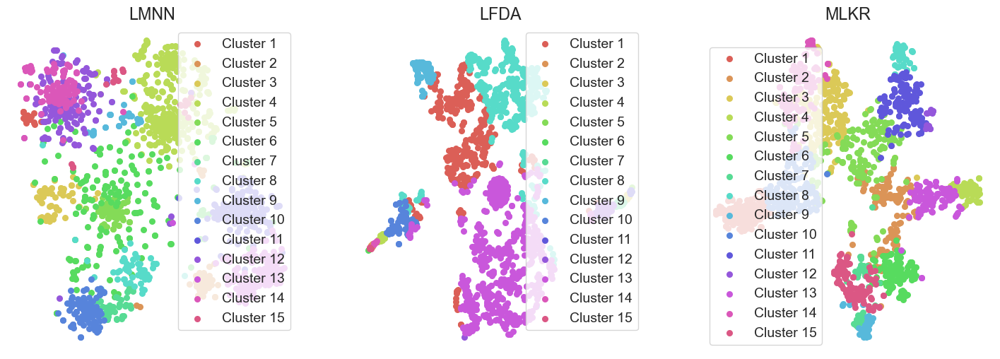

In [20]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from metric_learn import LMNN, LFDA, MLKR
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import silhouette_score

n_clusters = 15

# 1:13:6; 1 (5%) - test, 13 (65%) - train, 6 (30%) - val (из всей общей выборки)
train_data, temp_data = train_test_split(data, test_size=0.35)
# делим оставшиеся 35% на 30% для валидации и 5% для тестирования
val_data, test_data = train_test_split(temp_data, test_size=5/30)

# делим на фичи и таргет
vectorizer = TfidfVectorizer(max_df=0.9, min_df=5, max_features=1000)
X_train = vectorizer.fit_transform(train_data['content'])
X_val = vectorizer.transform(val_data['content'])
X_test = vectorizer.transform(test_data['content'])

# cluster_lanels
y_train = train_data['clusters']
y_val = val_data['clusters']
y_test = test_data['clusters']

# 5% обучающей выборки
X_train_small = X_train[:int(0.05 * X_train.shape[0])]
# Чтобы размерность таргета совпадала
y_train_small = y_train[:X_train_small.shape[0]]

# Используем LMNN, LFDA и MLKR
lmnn = LMNN(k=2)
lfda = LFDA()
mlkr = MLKR()

X_train_small = X_train_small.toarray()

# обучаем метрики
lmnn.fit(X_train_small, y_train_small)
lfda.fit(X_train_small, y_train_small)
mlkr.fit(X_train_small, y_train_small)

# применяем преобразование с обученными метриками, чтобы отобразить данные в пространтсво,
    # где расстояния между точками оптимизированы для кластеризации
X_train_mahalanobis_lmnn = lmnn.transform(X_train)
X_train_mahalanobis_lfda = lfda.transform(X_train)
X_train_mahalanobis_mlkr = mlkr.transform(X_train)

X_train_mahalanobis_lfda = np.real(X_train_mahalanobis_lfda)
X_train_mahalanobis_lfda = np.nan_to_num(X_train_mahalanobis_lfda)

X_train_mahalanobis_mlkr = np.real(X_train_mahalanobis_mlkr)
X_train_mahalanobis_mlkr = np.nan_to_num(X_train_mahalanobis_mlkr)

kmeans_lmnn = KMeans(n_clusters=n_clusters, random_state=42)
kmeans_lfda = KMeans(n_clusters=n_clusters, random_state=42)
kmeans_mlkr = KMeans(n_clusters=n_clusters, random_state=42)

# Кластеризуем данные методом KMeans с обученными метриками
cluster_kmean_lmnn = kmeans_lmnn.fit_predict(X_train_mahalanobis_lmnn)
cluster_kmeans_itml = kmeans_lfda.fit_predict(X_train_mahalanobis_lfda)
cluster_kmeans_mlkr = kmeans_mlkr.fit_predict(X_train_mahalanobis_mlkr)

# Оценка качества кластеризации
# silhouette_score -> 1: объект хорошо соответствует своему кластеру и далеко от других кластеров
# silhouette_score -> 0: объект находится на границе между двумя кластерами
# silhouette_score -> -1: объект неправильно отнесен к кластеру 
silhouette_lmnn = silhouette_score(X_train_mahalanobis_lmnn, cluster_kmean_lmnn)
silhouette_itml = silhouette_score(X_train_mahalanobis_lfda, cluster_kmeans_itml)
silhouette_mlkr = silhouette_score(X_train_mahalanobis_mlkr, cluster_kmeans_mlkr)

print(f"Silhouette Score для LMNN: {silhouette_lmnn}")
print(f"Silhouette Score для ITML: {silhouette_itml}")
print(f"Silhouette Score для SDML: {silhouette_mlkr}")

# Визуализация кластеров с использованием TSNE
tsne = TSNE(n_components=2, random_state=42)

X_train_tsne_lmnn = tsne.fit_transform(X_train_mahalanobis_lmnn)
X_train_tsne_lfda = tsne.fit_transform(X_train_mahalanobis_lfda)
X_train_tsne_mlkr = tsne.fit_transform(X_train_mahalanobis_mlkr)

fig, axes = plt.subplots(1, 3, figsize=(18, 6))

plot_tsne_clusters(axes, 0, X_train_tsne_lmnn, cluster_kmean_lmnn, "LMNN")
plot_tsne_clusters(axes, 1, X_train_tsne_lfda, cluster_kmeans_itml, "LFDA")
plot_tsne_clusters(axes, 2, X_train_tsne_mlkr, cluster_kmeans_mlkr, "MLKR")


In [21]:
from sklearn.model_selection import GridSearchCV

print("Логистическая регрессия на tf-idf признаках\n")
log_reg = LogisticRegression(max_iter=1000, solver='liblinear')

param_grid = {
    'C': [0.1, 1, 10, 20, 50],
    'penalty': ['l1', 'l2'],
}
grid_search_logreg = GridSearchCV(log_reg, param_grid, cv=2, scoring='accuracy', verbose=1)
grid_search_logreg.fit(X_train_small, y_train_small)
best_model_logreg = grid_search_logreg.best_estimator_
print("Лучшие параметры:", grid_search_logreg.best_params_)

# Прогнозирование на валидационной выборке для оценки промежуточной точности
y_val_logreg = best_model_logreg.predict(X_val)
print("Accuracy на валидационных данных:", accuracy_score(y_val, y_val_logreg))

# Финальная оценка на тестовой выборке
y_test_logreg = best_model_logreg.predict(X_test)
print("Accuracy на тестовых данных:", accuracy_score(y_test, y_test_logreg))


Логистическая регрессия на tf-idf признаках

Fitting 2 folds for each of 10 candidates, totalling 20 fits
Лучшие параметры: {'C': 20, 'penalty': 'l2'}
Accuracy на валидационных данных: 0.7303543913713405
Accuracy на тестовых данных: 0.7923076923076923


In [22]:
# Логистическая регрессия на расстояниях до центров кластеров
def logistic_regression_on_clusters(kmeans_model, X, y):
    # расстояния между точками и центрами кластеров
    distances = pairwise_distances(X, kmeans_model.cluster_centers_)
    clf = LogisticRegression(max_iter=1000)
    clf.fit(distances, y)
    return clf

In [23]:
print("K-Means с евклидовой метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров")
print("K-Means с обученной метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров\n")

kmeans_euclidean = KMeans(n_clusters=n_clusters, random_state=42)

param_grid = {
    'algorithm': ['lloyd', 'elkan'],  # различные алгоритмы для KMeans
    'init': ['k-means++', 'random'],  # различные способы инициализации центроидов
}

grid_search_euclidean = GridSearchCV(kmeans_euclidean, param_grid, cv=2, verbose=1, n_jobs=-1)
grid_search_lmnn = GridSearchCV(kmeans_lmnn, param_grid, cv=2, verbose=1, n_jobs=-1)
grid_search_lfda = GridSearchCV(kmeans_lfda, param_grid, cv=2, verbose=1, n_jobs=-1)
grid_search_mlkr = GridSearchCV(kmeans_mlkr, param_grid, cv=2, verbose=1, n_jobs=-1)

# Подгонка моделей
grid_search_euclidean.fit(X_train)
grid_search_lmnn.fit(X_train_mahalanobis_lmnn)
grid_search_lfda.fit(X_train_mahalanobis_lfda)
grid_search_mlkr.fit(X_train_mahalanobis_mlkr)

# Логистическая регрессия на расстояниях до центров кластеров
logreg_euclidean = logistic_regression_on_clusters(grid_search_euclidean.best_estimator_, X_train, y_train)
logreg_lmnn = logistic_regression_on_clusters(grid_search_lmnn.best_estimator_, X_train_mahalanobis_lmnn, y_train)
logreg_lfda = logistic_regression_on_clusters(grid_search_lfda.best_estimator_, X_train_mahalanobis_lfda, y_train)
logreg_mlkr = logistic_regression_on_clusters(grid_search_mlkr.best_estimator_, X_train_mahalanobis_mlkr, y_train)

# Расстояния до центров кластеров на валидационной выборке
distances_val_euclidean = pairwise_distances(X_val, grid_search_euclidean.best_estimator_.cluster_centers_)
distances_val_lmnn = pairwise_distances(X_val, grid_search_lmnn.best_estimator_.cluster_centers_)
distances_val_lfda = pairwise_distances(X_val, grid_search_lfda.best_estimator_.cluster_centers_)
distances_val_mlkr = pairwise_distances(X_val, grid_search_mlkr.best_estimator_.cluster_centers_)

# Оценка качества на валидационной выборке
y_pred_euclidean = logreg_euclidean.predict(distances_val_euclidean)
y_pred_lmnn = logreg_lmnn.predict(distances_val_lmnn)
y_pred_lfda = logreg_lfda.predict(distances_val_lfda)
y_pred_mlkr = logreg_mlkr.predict(distances_val_mlkr)

accuracy_euclidean = accuracy_score(y_val, y_pred_euclidean)
accuracy_lmnn = accuracy_score(y_val, y_pred_lmnn)
accuracy_lfda = accuracy_score(y_val, y_pred_lfda)
accuracy_mlkr = accuracy_score(y_val, y_pred_mlkr)

print("Accuracy (Euclidean):", accuracy_euclidean)
print("Accuracy (LMNN):", accuracy_lmnn)
print("Accuracy (LFDA):", accuracy_lfda)
print("Accuracy (MLKR):", accuracy_mlkr)


# Расстояния до центров кластеров на тестовой выборке
distances_test_euclidean = pairwise_distances(X_test, grid_search_euclidean.best_estimator_.cluster_centers_)
distances_test_lmnn = pairwise_distances(X_test, grid_search_lmnn.best_estimator_.cluster_centers_)
distances_test_lfda = pairwise_distances(X_test, grid_search_lfda.best_estimator_.cluster_centers_)
distances_test_mlkr = pairwise_distances(X_test, grid_search_mlkr.best_estimator_.cluster_centers_)

# Оценка качества на тестовой выборке
y_pred_test_euclidean = logreg_euclidean.predict(distances_test_euclidean)
y_pred_test_lmnn = logreg_lmnn.predict(distances_test_lmnn)
y_pred_test_lfda = logreg_lfda.predict(distances_test_lfda)
y_pred_test_mlkr = logreg_mlkr.predict(distances_test_mlkr)

accuracy_test_euclidean = accuracy_score(y_test, y_pred_test_euclidean)
accuracy_test_lmnn = accuracy_score(y_test, y_pred_test_lmnn)
accuracy_test_lfda = accuracy_score(y_test, y_pred_test_lfda)
accuracy_test_mlkr = accuracy_score(y_test, y_pred_test_mlkr)

print("Test Accuracy (Euclidean):", accuracy_test_euclidean)
print("Test Accuracy (LMNN):", accuracy_test_lmnn)
print("Test Accuracy (LFDA):", accuracy_test_lfda)
print("Test Accuracy (MLKR):", accuracy_test_mlkr)


K-Means с евклидовой метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
K-Means с обученной метрикой на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

Fitting 2 folds for each of 4 candidates, totalling 8 fits
Fitting 2 folds for each of 4 candidates, totalling 8 fits
Fitting 2 folds for each of 4 candidates, totalling 8 fits
Fitting 2 folds for each of 4 candidates, totalling 8 fits


c:\Users\LenanXD\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy (Euclidean): 0.8120184899845917
Accuracy (LMNN): 0.8289676425269645
Accuracy (LFDA): 0.2295839753466872
Accuracy (MLKR): 0.13559322033898305
Test Accuracy (Euclidean): 0.8461538461538461
Test Accuracy (LMNN): 0.8769230769230769
Test Accuracy (LFDA): 0.25384615384615383
Test Accuracy (MLKR): 0.14615384615384616


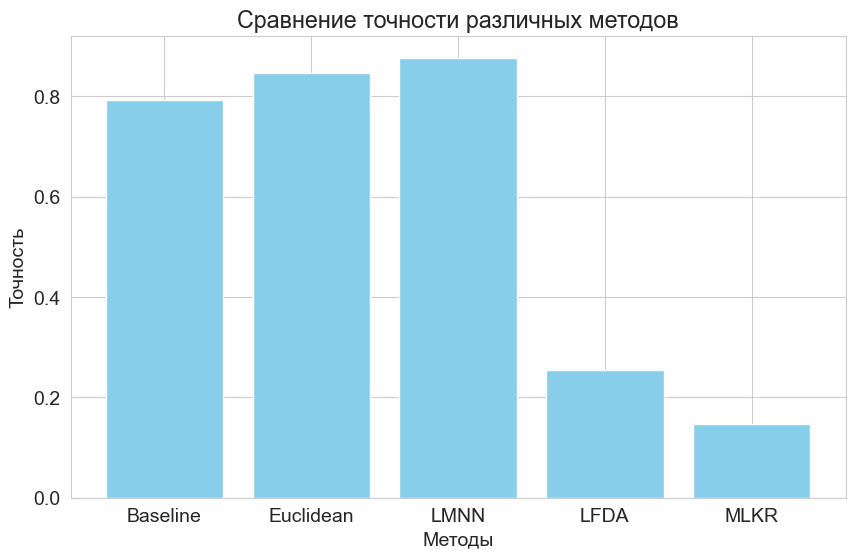

In [24]:
baseline_acc = accuracy_score(y_test, y_test_logreg)
acc = [baseline_acc, accuracy_test_euclidean, accuracy_test_lmnn, accuracy_test_lfda, accuracy_test_mlkr]

methods = ['Baseline', 'Euclidean', 'LMNN', 'LFDA', 'MLKR']

plt.figure(figsize=(10, 6))
plt.bar(methods, acc, color='skyblue')

plt.title('Сравнение точности различных методов')
plt.xlabel('Методы')
plt.ylabel('Точность')

# Отображение диаграммы
plt.show()


(?) Сделайте выводы о применимости методов кластеризации для улучшения качества классификации. **За отсутствие выводов будет наложен штраф до 2.5 баллов.**

**Ответ:**
### Логистическая регрессия на tf-idf признака

Логистическая регрессия на основе tf-idf признаков работает очень хорошо для классификации текста. Это подтверждает, что для данной задачи tf-idf признаки достаточно информативны и простая модель, такая как логистическая регрессия, вполне способна хорошо работать на таких признаках.

### K-Means с евклидовой метрикой

Несмотря на то, что K-Means помогает разделить данные на кластеры, использование евклидовой метрики не совсем идеально для текстов. Эта метрика не учитывает семантическую близость слов, поэтому результаты хуже, чем у логистической регрессии.

### K-Means с обученной метрикой

LMNN улучшает результаты, потому что он обучается учитывать, какие документы должны быть близки друг к другу в векторном пространстве, что помогает лучше классифицировать текст.

LFDA плохо работает, когда классы не разделяются линейно.

MLKR не подходит для классификации текста, потому что он больше ориентирован на задачи регрессии.